# **Network analysis - second part**

In this notebook, we will create networks between the individuals by their link to the same university at the same period. Then, conversely, we will realize a network between the organizations by the same individual.
In the second, we will make the network analysis. For create the network relation, you have to go to the **[first part](https://github.com/Semantic-Data-for-Humanities/Economists_Jurists/blob/main/Notebooks/Analysis_network_educatedAt_Script_part2.ipynb)**.

In [137]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import networkx as nx
import sqlite3

In [138]:
import pprint
import csv
import ast
import re

from collections import Counter, defaultdict
from operator import itemgetter

import sqlite3 as sql
import time

from importlib import reload
from shutil import copyfile

import math

In [4]:
df=pd.read_csv("spreadsheets/network_educatedAt.csv", sep="|")

In [5]:
# Group by universities
universities = df.groupby(['educatedAt']).size()
print(len(universities))
list(universities.sort_values(ascending=False).items())[10:20]

1972


[('Columbia University', 29304),
 ('University of Barcelona', 27070),
 ('University of Buenos Aires', 26804),
 ('Complutense University of Madrid', 26424),
 ('University of Michigan Law School', 25944),
 ('University of California, Berkeley', 25398),
 ('Stanford University', 22522),
 ('University of Chicago', 21562),
 ('Georgetown University Law Center', 20248),
 ('University of Oslo', 18494)]

In [4]:
# Returns a graph containing an edge list.
G = nx.from_pandas_edgelist(df, 'person_1', 'person_2', edge_attr='educatedAt')
print(nx.info(G))

NameError: name 'df' is not defined

In [7]:
G.is_multigraph(), G.is_directed(), G.number_of_nodes(), G.number_of_edges(), nx.is_connected(G), nx.density(G)

(False, False, 44958, 888508, False, 0.0008791986899536982)

In [8]:
# Return the number of connected components.
nx.number_connected_components(G)

824

In [9]:
## degree entrality and dispersion
df_degree = pd.DataFrame(list(nx.degree(G)), columns = ['person', 'degree'])
df_degree.head()
df_degree.set_index('person',inplace=True)
df_degree.head()

,degree
person,
Stephen Harper,2
Brian Jean,3
Gary Kovacs,2
Joseph C. O'Mahoney,65
Albert Levitt,179


In [10]:
df_degree['degree'].describe()

count    44958.000000
mean        39.526136
std         55.830477
min          1.000000
25%          7.000000
50%         19.000000
75%         48.000000
max        529.000000
Name: degree, dtype: float64

In [11]:
gr_degree = df_degree.groupby(['degree']).size()
gr_degree.sort_index()

degree
1      2055
2      1884
3      1615
4      1606
5      1487
       ... 
516       1
517       1
519       1
523       1
529       1
Length: 408, dtype: int64

[1, 2, 3, 4, 5]


<BarContainer object of 408 artists>

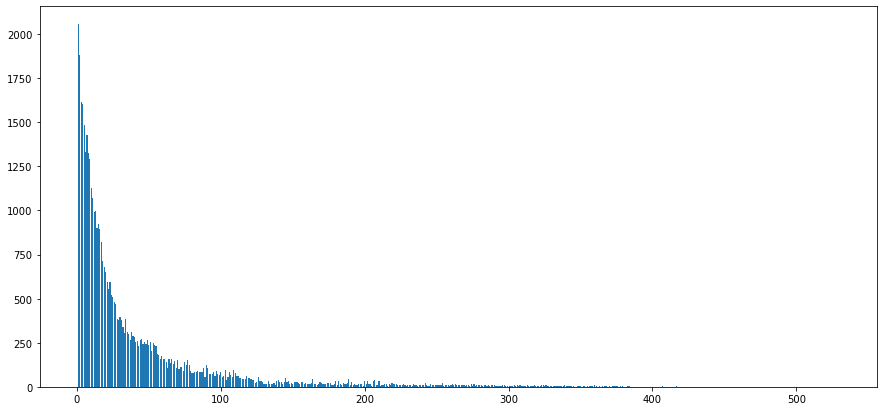

In [12]:
### Degree distribution

gr_degree = df_degree.groupby(['degree']).size()


objects = [l for l in gr_degree.index]
freq = [l for l in gr_degree]

print(objects[:5])
plt.figure(figsize=(15,7))
plt.bar(objects, freq)

In [13]:
df_degree[df_degree['degree'] > 250]

,degree
person,
Brad Miller,260
D. Price Marshall Jr.,314
David E. Van Zandt,274
Jeremy Heywood,350
José Viñals Íñiguez,356
Robert F. Kennedy Jr.,333
Robert J. Shapiro,411
Charles O. Porter,279
Jens Evensen,320


In [14]:
nx.number_connected_components(G)

824

In [15]:
### graph components
# https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.components.connected_components.html
c_comp = nx.connected_components(G)
print(type(c_comp))
## Length of generator as set of nodes = number of nodes
df_c_comp = pd.DataFrame([len(c) for c in sorted(c_comp, key=len, reverse=True)], columns=['eff'])
gs_c_comp = df_c_comp.groupby(['eff']).size()
gs_c_comp.sort_index()

<class 'generator'>


eff
2        457
3        170
4         63
5         37
6         26
7         19
8          9
9          7
10         2
11         6
12         4
13         2
14         1
15         3
16         2
17         2
18         1
19         1
21         1
24         1
29         2
36         3
37         1
49         1
50         1
52         1
41952      1
dtype: int64

In [15]:
### To create the corresponding subgraph to each component :
#  https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.components.connected_components.html
S = [[len(c), G.subgraph(c).copy()] for c in nx.connected_components(G)]
# type(S)

In [16]:
### Choose the component(s) to 52 nodes:
a = [[s[0], s[1]] for s in S if s[0] == 52]
a

[[52, <networkx.classes.graph.Graph at 0x7f76771fc850>]]

In [17]:
sub_g = a[0][1]
ll = [{(l[0],l[1]):l[2]['educatedAt']} for l in list(sub_g.edges.data())]
edge_labels = defaultdict(list)
{edge_labels[key].append(sub[key]) for sub in ll for key in sub} 

{None}

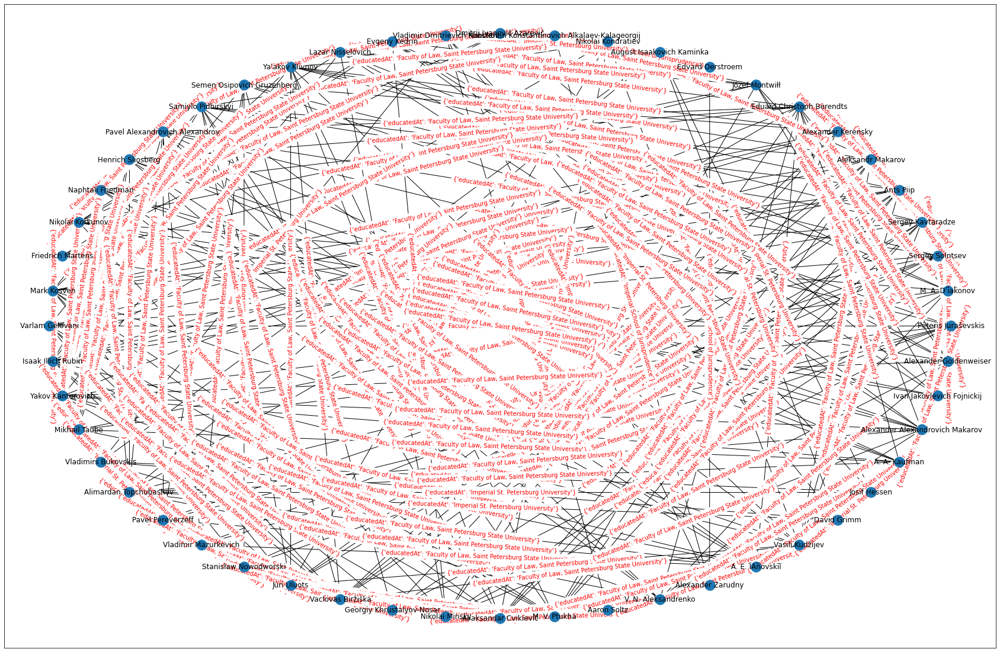

In [21]:
# Display the sub-graph 
plt.figure(figsize=(30,20))
pos = nx.circular_layout(sub_g)
el = nx.draw_networkx_edge_labels(sub_g, pos, edge_labels = edge_labels, font_size = 10, font_color = 'red')
#print(edge_labels)
nx.draw_networkx(sub_g,pos)

In [22]:
### Choose the component(s) to 36 nodes 
a36 = [[s[0], s[1]] for s in S  if s[0] == 36]
a36

[[36, <networkx.classes.graph.Graph at 0x7f7677d6eb90>],
 [36, <networkx.classes.graph.Graph at 0x7f767725efd0>],
 [36, <networkx.classes.graph.Graph at 0x7f76771916d0>]]

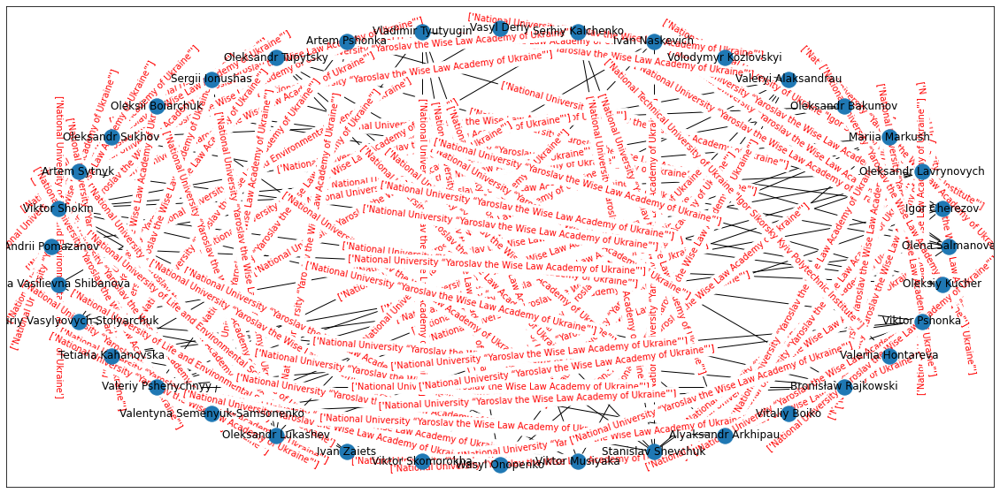

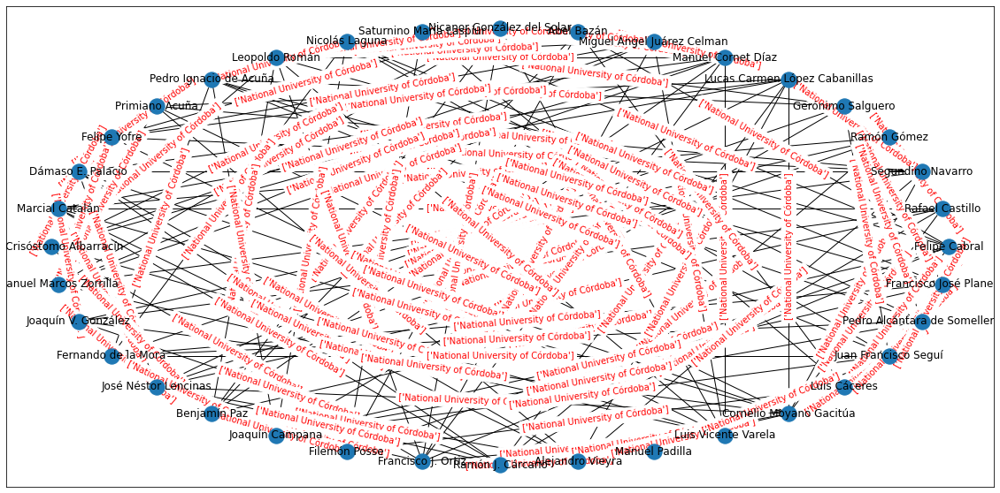

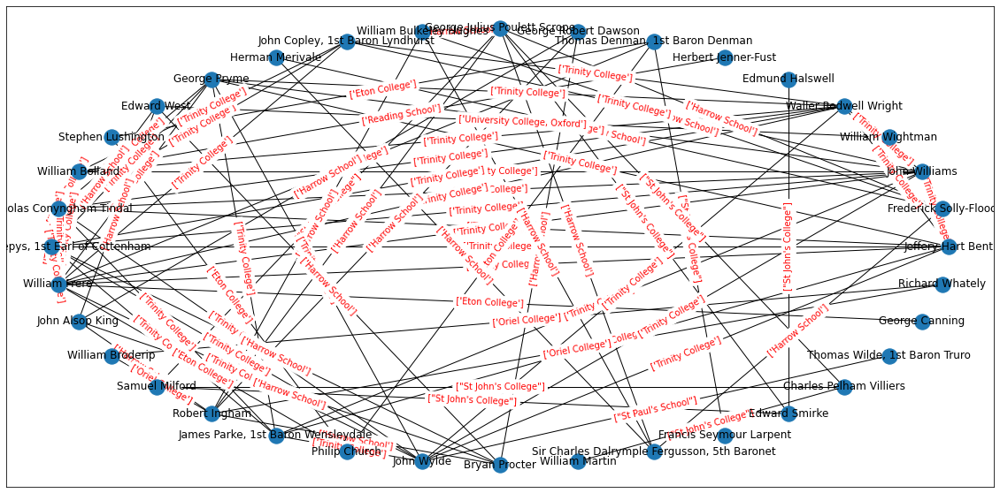

In [23]:
for g in a36:
    sub_g = g[1]
    ll = [{(l[0],l[1]):l[2]['educatedAt']} for l in list(sub_g.edges.data())]
    edge_labels = defaultdict(list)
    e = {edge_labels[key].append(sub[key]) for sub in ll for key in sub} 
    plt.figure(figsize=(20,10))
    pos = nx.circular_layout(sub_g)
    el = nx.draw_networkx_edge_labels(sub_g, pos, edge_labels = edge_labels, font_size = 10, font_color = 'red')
    # print(edge_labels)
    nx.draw_networkx(sub_g,pos)

## **Subgraph**

In [24]:
### Choose the component(s) to 41952 nodes 

a41952= [[s[0], s[1]] for s in S  if s[0] == 41952]
a41952
sub_g = a41952[0][1]

In [25]:
print(nx.info(sub_g))

Name: 
Type: Graph
Number of nodes: 41952
Number of edges: 883788
Average degree:  42.1333


In [26]:
nx.is_connected(sub_g), nx.density(sub_g)

(True, 0.0010043454314440183)

In [28]:
### Returns all maximal cliques in an undirected graph.
# https://networkx.org/documentation/stable/reference/algorithms/clique.html?highlight=cliques

cliques = [(len(c),c) for c in list(nx.find_cliques(sub_g)) if len(c) > 2]
print(len(cliques))
#cliques[-3:]

30370


In [47]:
df_cliques = pd.DataFrame([l[0] for l in cliques], columns = ['freq'])
gs_cliques = df_cliques.groupby(['freq']).size()
gs_cliques.sort_index()[-75:]

freq
63      8
64     11
65      7
66      9
67      7
       ..
151     1
152     2
153     1
155     1
156     2
Length: 75, dtype: int64

In [31]:
#[c for c in cliques if c[0] == 32]

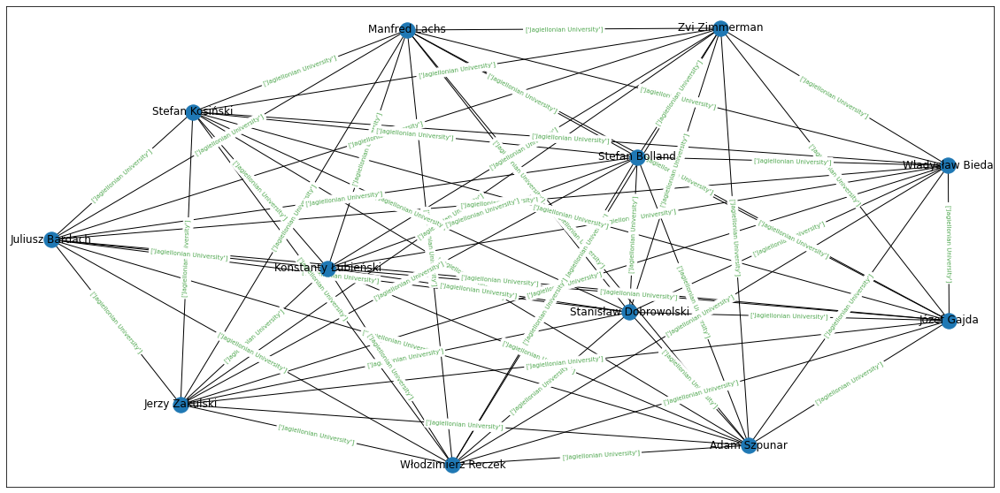

In [35]:
pos = ''
cc = [c[1] for c in cliques if c[0] == 32]

sub_32 = G.subgraph(cc[0]).copy()
ll = [{(l[0],l[1]):l[2]['educatedAt']} for l in list(sub_32.edges.data())]
edge_labels = defaultdict(list)
e = {edge_labels[key].append(sub[key]) for sub in ll for key in sub} 
plt.figure(figsize=(20,10))
pos = nx.spring_layout(sub_32)
el = nx.draw_networkx_edge_labels(sub_32, pos, edge_labels = edge_labels, font_size = 7, alpha = 0.7, font_color = 'green')
# print(edge_labels)
nx.draw_networkx(sub_32,pos)

In [ ]:
from networkx.algorithms import approximation as apxa
##  exécution très longue : vérifier
apxa.k_components(sub_g, min_density = 0.95)

In [18]:
lk_67 = df_degree[df_degree['degree']> 67]
list(lk_67.index[:3])

['Albert Levitt', 'Alexander Holtzoff', 'Amedeo Natoli']

In [19]:
#  https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.components.connected_components.html
lk_67 = G.subgraph(list(lk_67.index)).copy()
print(nx.info(lk_67))

Name: 
Type: Graph
Number of nodes: 7567
Number of edges: 457730
Average degree: 120.9806


In [20]:
nx.number_connected_components(lk_67)

1

In [21]:
### graph components
# cf. https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.components.connected_components.html
c_comp = nx.connected_components(lk_67)
print(type(c_comp))
## Length of generator as set of nodes = number of nodes
df_c_comp = pd.DataFrame([len(c) for c in sorted(c_comp, key=len, reverse=True)], columns=['freq'])
gs_c_comp = df_c_comp.groupby(['freq']).size()
gs_c_comp.sort_index()

<class 'generator'>


freq
7567    1
dtype: int64

In [22]:
### Create subgraphs corresponding to the components
# https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.components.connected_components.html
S = [[len(c), G.subgraph(c).copy()] for c in nx.connected_components(lk_67)]
# type(S)

In [23]:
a = [[s[0], s[1]] for s in S  if s[0] == 7567]
g7567 = a[0][1]

In [57]:
fig = plt.figure(figsize=(400,200))
pos = nx.kamada_kawai_layout(g7567)
nx.draw_networkx(g7567, pos , font_color = 'red', font_size=30, edge_color='LightGray' )
#plt.savefig("graphs/dk_13.jpg", format="jpg")
plt.savefig("graphs/dk_7567.pdf", format="pdf")
#plt.show()

KeyboardInterrupt: 

<Figure size 28800x14400 with 0 Axes>

## **Add subgraph centrality settings**

### **degree centrality**

In [24]:
# Construct the dictionary with the format
degree = dict([(d[0], {'degree': d[1]}) for d in nx.degree(g7567)])
print(list(degree)[:3])

['D. Brock Hornby', 'Nigel S. Wright', 'Masaaki Imai']


In [25]:
nx.set_node_attributes(g7567, degree)

### **closeness centrality**

The closeness centrality measures  the proximity between nodes (shortest path). 
cf. https://en.wikipedia.org/wiki/Closeness_centrality
cf. https://networkx.org/documentation/networkx-1.10/reference/generated/networkx.algorithms.centrality.closeness_centrality.html

In [26]:
closeness = nx.closeness_centrality(g7567)

In [27]:
nx.set_node_attributes(g7567, closeness, 'closeness')

### **betweeness centrality**
The betweenness centrality is a measure of centrality that counts the number of times a node appears into the shortest paths of the graph.

cf. https://en.wikipedia.org/wiki/Betweenness_centrality

cf. https://networkx.org/documentation/networkx-1.10/reference/generated/networkx.algorithms.centrality.betweenness_centrality.html

In [29]:
betweenness = nx.betweenness_centrality(g7567)

In [30]:
nx.set_node_attributes(g7567, betweenness, 'betweenness')

### **eigenvector centrality**
The eigenvector centrality is measure of the influence of the node. Each node with a highscore is connected to other ones have themself.
cf. https://en.wikipedia.org/wiki/Eigenvector_centrality

In [31]:
### https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.centrality.eigenvector_centrality.html?highlight=eigenvector#networkx.algorithms.centrality.eigenvector_centrality
eigenvector = nx.eigenvector_centrality(g7567)
nx.set_node_attributes(g7567, eigenvector, 'eigenvector')

In [32]:
print(list(g7567.nodes.data())[:5])

[('D. Brock Hornby', {'degree': 251, 'closeness': 0.2982497634815516, 'betweenness': 0.00010656783574725207, 'eigenvector': 0.0335037926395505}), ('Nigel S. Wright', {'degree': 224, 'closeness': 0.24122429459588712, 'betweenness': 0.00010514413012531129, 'eigenvector': 0.023693585481621295}), ('Masaaki Imai', {'degree': 145, 'closeness': 0.26886993603411513, 'betweenness': 0.00025521965164206, 'eigenvector': 5.951239104529263e-05}), ('Michael Ratner', {'degree': 69, 'closeness': 0.271884432945235, 'betweenness': 1.298843319301613e-05, 'eigenvector': 0.0009458731458232974}), ('Alberto Undurraga', {'degree': 24, 'closeness': 0.21679083094555873, 'betweenness': 7.463789702922493e-05, 'eigenvector': 0.00015196132182146208})]


In [33]:
node_sizes = [i[1]['betweenness'] * 100000 + 1000 for i in list(g7567.nodes.data())]
print(len(node_sizes))
node_sizes[:4]

7567


[1010.6567835747252, 1010.5144130125311, 1025.521965164206, 1001.2988433193016]

In [34]:
fig = plt.figure(figsize=(200,100))
pos = nx.kamada_kawai_layout(g7567)
nx.draw_networkx(g7567, pos, node_color = 'DarkBlue', font_color = 'CornflowerBlue',\
                 font_size=30, node_size=node_sizes, edge_color='LightGray' )
plt.savefig("graphs/g7567.pdf", format="pdf")
plt.savefig("graphs/g7567.jpg", format="jpg")
plt.show()

KeyboardInterrupt: 

<Figure size 14400x7200 with 0 Axes>

In [35]:
node_sizes = [i[1]['eigenvector'] * 100000 + 1000 for i in list(g7567.nodes.data())]
print(len(node_sizes))
node_sizes[:4]

7567


[4350.37926395505, 3369.3585481621294, 1005.9512391045292, 1094.5873145823298]

In [ ]:
fig = plt.figure(figsize=(200,100))
pos = nx.kamada_kawai_layout(g7567)
nx.draw_networkx(g7567, pos, node_color = 'DarkBlue', font_color = 'CornflowerBlue',\
                 font_size=30, node_size=node_sizes, edge_color='LightGray' )
plt.savefig("graphs/g7567_eigenvector.pdf", format="pdf")
plt.savefig("graphs/g7567_eigenvector.jpg", format="jpg")
plt.show()

In [36]:
### Export attributes
export = pd.DataFrame(g7567.nodes.data(), columns = ['id', 'attributes'])
export.head()

,id,attributes
0,D. Brock Hornby,"{'degree': 251, 'closeness': 0.298249763481551..."
1,Nigel S. Wright,"{'degree': 224, 'closeness': 0.241224294595887..."
2,Masaaki Imai,"{'degree': 145, 'closeness': 0.268869936034115..."
3,Michael Ratner,"{'degree': 69, 'closeness': 0.271884432945235,..."
4,Alberto Undurraga,"{'degree': 24, 'closeness': 0.2167908309455587..."
5,William Acker,"{'degree': 80, 'closeness': 0.2486852484880357..."
6,"Carlos Fitz-James Stuart, 19th Duke of Alba","{'degree': 120, 'closeness': 0.252216814454296..."
7,Itaru Seki,"{'degree': 98, 'closeness': 0.1793656061827319..."
8,"Raoul G. Cantero, III","{'degree': 256, 'closeness': 0.256901293674238..."
9,Üner Kırdar,"{'degree': 60, 'closeness': 0.2594294335482101..."


In [41]:
### Break down 'attributes' fields
# https://stackoverflow.com/questions/38231591/split-explode-a-column-of-dictionaries-into-separate-columns-with-pandas
from pandas.io.json import json_normalize
json_normalize(export.attributes)

,degree,closeness,betweenness,eigenvector
0,251,0.298250,1.065678e-04,3.350379e-02
1,224,0.241224,1.051441e-04,2.369359e-02
2,145,0.268870,2.552197e-04,5.951239e-05
3,69,0.271884,1.298843e-05,9.458731e-04
4,24,0.216791,7.463790e-05,1.519613e-04
5,80,0.248685,4.781148e-05,7.900403e-05
6,120,0.252217,2.714224e-05,1.622145e-04
7,98,0.179366,2.003498e-04,6.238987e-08
8,256,0.256901,1.241826e-04,3.583453e-02
9,60,0.259429,2.741748e-05,3.602780e-04


In [42]:
### apply to the dataframe and remove attributs columns
# at the same put name as index
export = export.join(json_normalize(export.attributes)).set_index('id')
export.drop(columns=['attributes'], inplace=True)

In [43]:
# Example individual
export.loc[['Nigel S. Wright']]

,degree,closeness,betweenness,eigenvector
id,,,,
Nigel S. Wright,224,0.241224,0.000105,0.023694


In [44]:
export['closeness'].describe()

count    7567.000000
mean        0.244084
std         0.041446
min         0.094041
25%         0.218860
50%         0.254174
75%         0.274255
max         0.325896
Name: closeness, dtype: float64

In [45]:
export['betweenness'].describe()

count    7567.000000
mean        0.000430
std         0.002303
min         0.000000
25%         0.000047
50%         0.000106
75%         0.000270
max         0.099622
Name: betweenness, dtype: float64

In [46]:
export['eigenvector'].describe()

count    7.567000e+03
mean     4.417943e-03
std      1.061364e-02
min      1.619662e-19
25%      2.771578e-05
50%      4.678872e-04
75%      2.023795e-03
max      6.612815e-02
Name: eigenvector, dtype: float64

In [47]:
export.sort_values(by=['eigenvector'], ascending=False).iloc[80:90]  # .iloc[50:90]   .head(50)

,degree,closeness,betweenness,eigenvector
id,,,,
Zinat Ara,276,0.295362,0.000253,0.051639
George Valentine,275,0.294580,0.000174,0.051635
Sandile Ngcobo,275,0.294580,0.000174,0.051635
Robert Lewis Hinkle,279,0.294810,0.000130,0.051589
Colleen McMahon,280,0.295478,0.000179,0.051579
Pauline Kingi,278,0.294798,0.000128,0.051568
Walter Kälin,278,0.294798,0.000128,0.051568
Dale S. Fischer,278,0.294798,0.000128,0.051568
"Thomas W. Thrash, Jr.",278,0.294798,0.000128,0.051568


In [48]:
export.loc[['Nigel S. Wright']]

,degree,closeness,betweenness,eigenvector
id,,,,
Nigel S. Wright,224,0.241224,0.000105,0.023694


In [49]:
export.loc[export.index.isin(['Nigel S. Wright'])]  ### négation :  loc[~export.index.isin(['Ellen_Johnson_Sirleaf'])]  

,degree,closeness,betweenness,eigenvector
id,,,,
Nigel S. Wright,224,0.241224,0.000105,0.023694


### **Relations between centralities properties and attributes**
#### **Relations between two centralities**

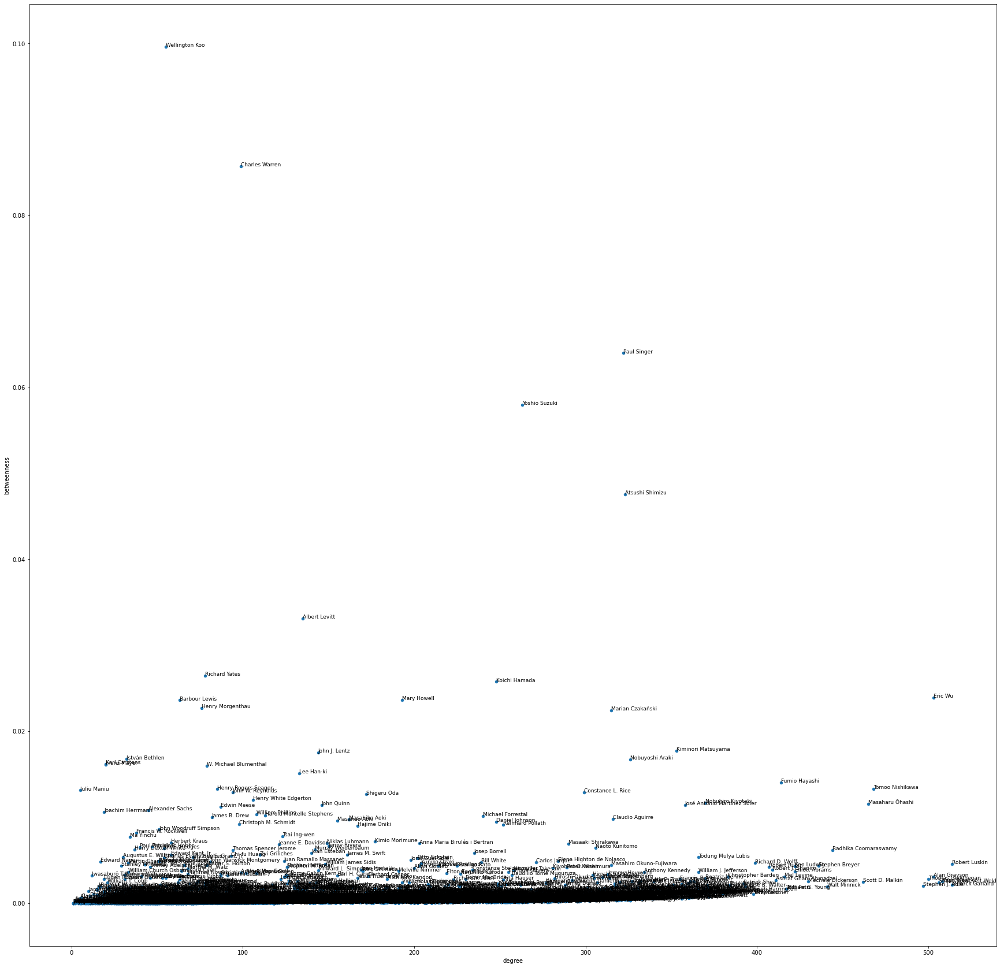

In [50]:
export[['degree','betweenness']].plot(x = 'degree', y = 'betweenness',kind='scatter',figsize=(30,30))
for i,row in list(export[['degree','betweenness']].iterrows()):
    plt.annotate(i,(row['degree'], row['betweenness']), fontsize = 9, stretch='semi-expanded')

In [55]:
export.sort_values(by=['eigenvector'], ascending=False).iloc[400:450]

,degree,closeness,betweenness,eigenvector
id,,,,
Robert Joffe,238,0.294879,0.000122,0.028280
Mary Mullarkey,238,0.294879,0.000122,0.028280
Fernando Carrillo Florez,266,0.257303,0.000329,0.028034
Dave Jones,266,0.257303,0.000329,0.028034
Steve Eisman,247,0.256188,0.000409,0.027834
Michael J. Juneau,236,0.248334,0.000123,0.027739
Sundaresh Menon,234,0.248220,0.000103,0.027735
Andrew Patrick Gordon,234,0.248220,0.000103,0.027735
Richard Snowden,234,0.248220,0.000103,0.027735


In [56]:
len(export), len(export.loc[~export.index.isin(['Mary Ellen Turpel-Lafond', 'Lois Murphy', 'Patricia Millett'])])

(7567, 7564)

In [58]:
exp_Wright = export[['closeness','eigenvector']].loc[~export.index.isin(['Mary Ellen Turpel-Lafond', 'Lois Murphy', 'Patricia Millett'])][export['eigenvector']> 0.05]\
.sort_values('eigenvector', ascending=False).copy(deep=True)

/home/sylvain/anaconda3/envs/Github/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


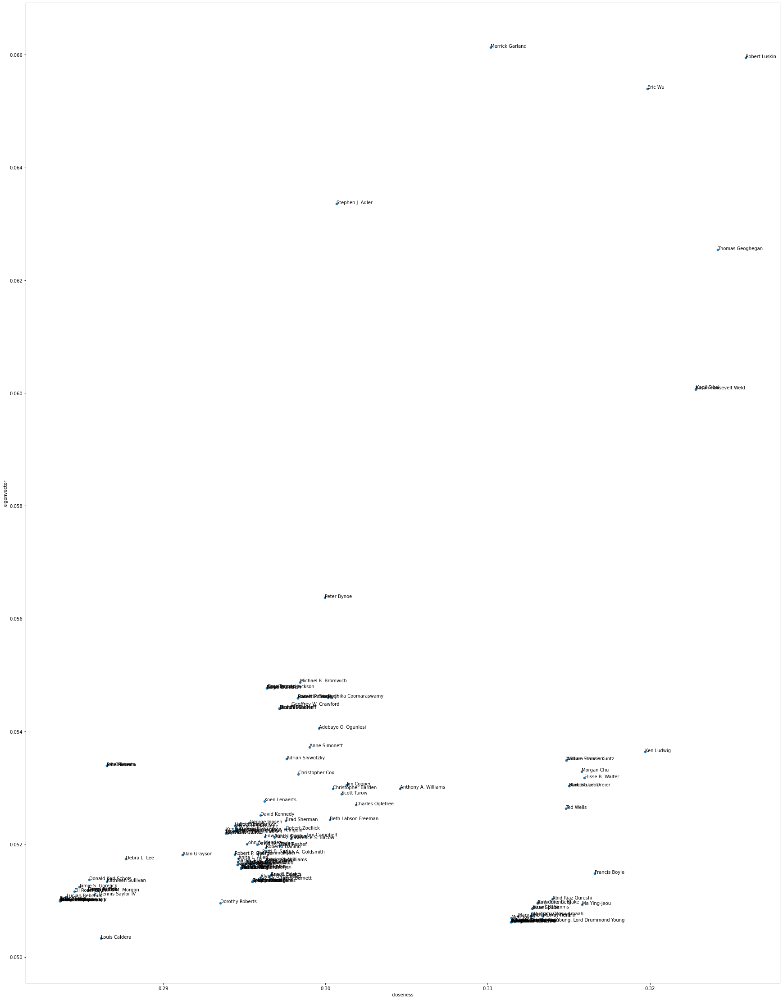

In [60]:
exp_Wright.sort_values('eigenvector', ascending=False).plot(x = 'closeness', y = 'eigenvector',kind='scatter',figsize=(30,40))
for i,row in list(exp_Schwab.iterrows()):
    plt.annotate(i,(row['closeness'], row['eigenvector']), fontsize = 10, stretch='expanded')
plt.savefig('exported_pictures/networks/closeness_eigenvector_20210718.jpg')

## Ego network

We take the same example of Nigel S. Wright and realise his ego network

In [61]:
wright_ego = nx.ego_graph(g7567, 'Nigel S. Wright', radius = 2, undirected=True)
print(len(wright_ego))

1628


In [62]:
wright_ego

In [63]:
node_sizes = [i[1]['betweenness'] * 100000 + 1000 for i in list(wright_ego.nodes.data())]
print(len(node_sizes))
node_sizes[:4]

1628


[1155.3431678957422,
 1006.8875259159124,
 1010.5144130125311,
 1007.4637897029224]

In [64]:
fig = plt.figure(figsize=(200,100))
pos = nx.kamada_kawai_layout(wright_ego)
nx.draw_networkx(wright_ego, pos, node_color = 'DarkBlue', font_color = 'CornflowerBlue',\
                 font_size=30, node_size=node_sizes, edge_color='LightGray' )
#plt.savefig("graphs/wright_ego.pdf", format="pdf")
plt.show()

## **Link between organizations**

Now, we will realize the same process with the organization. A relation is created when an individual has been in two organizations.

In [77]:
link_edu = '''
SELECT         net1.educatedAt AS orga_1,
               net2.educatedAt AS orga_2,
               net1.name AS person,
               net1.year_birth AS birth_year,
               net1.longitude AS long_1,
               net2.longitude AS long_2,
               net1.latitude AS lat_1,
               net2.latitude AS lat_2
FROM net net1, net net2
WHERE net1.name = net2.name
AND net1.educatedAt != net2.educatedAt
AND net1.longitude != net2.longitude
AND net1.latitude != net2.latitude
ORDER BY person
    '''

In [78]:
df = pd.read_sql_query(link_edu, conn)

In [79]:
df.to_csv("spreadsheets/Network/network_organizations.csv", sep="|")

In [103]:
df=pd.read_csv("spreadsheets/Network/network_organizations.csv", sep="|")

In [104]:
students = df.groupby(['person']).size()
print(len(students))
list(students.sort_values(ascending=False).items())[:10] #[10:20]

16179


[('Stephen M. Ross', 56),
 ('José-Apeles Santolaria de Puey y Cruells', 56),
 ('Richard Yates', 54),
 ('Ellen Euler', 42),
 ('David Vitter', 42),
 ('James E. Rogers', 42),
 ('Pauli Murray', 42),
 ('John Warwick Montgomery', 42),
 ('Jessie Sumner', 42),
 ('David Lewis', 30)]

In [105]:
# Example with Jessie Sumner
df[df['person'] == 'Jessie Sumner'][:10]

,Unnamed: 0,orga_1,orga_2,person,birth_year,long_1,long_2,lat_1,lat_2
27320,27320,New York University,Columbia University,Jessie Sumner,1898.0,-73.995,-73.961944,40.730,40.807500
27321,27321,New York University,New York University Stern School of Business,Jessie Sumner,1898.0,-73.995,-73.995900,40.730,40.729600
27322,27322,New York University,Smith College,Jessie Sumner,1898.0,-73.995,-72.637500,40.730,42.317500
27323,27323,New York University,University of Chicago,Jessie Sumner,1898.0,-73.995,-87.599722,40.730,41.789722
27324,27324,New York University,University of Oxford,Jessie Sumner,1898.0,-73.995,-1.255000,40.730,51.755000
27325,27325,New York University,University of Wisconsin–Madison,Jessie Sumner,1898.0,-73.995,-89.409722,40.730,43.075278
27326,27326,University of Oxford,Columbia University,Jessie Sumner,1898.0,-1.255,-73.961944,51.755,40.807500
27327,27327,University of Oxford,New York University,Jessie Sumner,1898.0,-1.255,-73.995000,51.755,40.730000
27328,27328,University of Oxford,New York University Stern School of Business,Jessie Sumner,1898.0,-1.255,-73.995900,51.755,40.729600
27329,27329,University of Oxford,Smith College,Jessie Sumner,1898.0,-1.255,-72.637500,51.755,42.317500


In [106]:
# Count the number of individuals with their link with both organizations
df_students = pd.DataFrame(students, columns=['eff'])
gdf_students = df_students.groupby(['eff']).size()
gdf_students.sort_index(ascending=True)[:20]

eff
2     11558
4        19
6      3572
10       14
12      810
18        5
20      150
28        4
30       38
42        6
54        1
56        2
dtype: int64

In [107]:
### Fonction to add the activity period

# several activity periods are possible for the same person

def activity_period(birth_year):    
    period_value = []
    if (int(birth_year) + 25) < 1901:
        period_value.append("-1900")        
    # The second clause excludes people probably who no longer works even if born before the indicated date.
    if (int(birth_year) + 75) > 1900 and (int(birth_year) + 25) < 1946:
        period_value.append("1901-1945")
    if (int(birth_year) + 75) > 1945:
        period_value.append("1946-")
    return period_value    

In [108]:
activity_period(1860), activity_period(1873), activity_period(1900)

(['-1900', '1901-1945'],
 ['-1900', '1901-1945', '1946-'],
 ['1901-1945', '1946-'])

In [109]:
# Apply the activity period to the persons with the activity_period function

df['activity_period'] = df['birth_year'].apply (lambda x : activity_period(x) ) 
df.head()

,Unnamed: 0,orga_1,orga_2,person,birth_year,long_1,long_2,lat_1,lat_2,activity_period
0,0,Howard University,Lincoln University,"A. A. Birch, Jr.",1932.0,-77.020000,-75.927778,38.921667,39.808333,[1946-]
1,1,Lincoln University,Howard University,"A. A. Birch, Jr.",1932.0,-75.927778,-77.020000,39.808333,38.921667,[1946-]
2,2,Yale Law School,Regis University,A. Andrew Hauk,1912.0,-72.928147,-105.031765,41.311581,39.789693,"[1901-1945, 1946-]"
3,3,Regis University,Yale Law School,A. Andrew Hauk,1912.0,-105.031765,-72.928147,39.789693,41.311581,"[1901-1945, 1946-]"
4,4,Harvard Law School,Tufts University,A. Arthur Giddon,1909.0,-71.118500,-71.119820,42.377972,42.406949,"[1901-1945, 1946-]"


### **Count the links per activity period**

In [110]:
### It is necessary first to transform list into string
activities = []
for pa in ['-1900', '1901-1945', '1946-']:
    for lu in df['activity_period']:
        for pe in lu:
            if pa == pe:
                activities.append(pa)

In [111]:
Counter(activities)

Counter({'-1900': 6598, '1901-1945': 16460, '1946-': 53487})

In [112]:
### Links between the three activity periods: On how much period is present the link
freq_periods = df.groupby(df['activity_period'].apply(lambda x : len(x))).size()
freq_periods

activity_period
1    42784
2    15619
3      841
dtype: int64

### **Creation of the graph**

In [113]:
# Create the graph
GU = nx.from_pandas_edgelist(df, 'orga_1', 'orga_2', ['person','birth_year','activity_period','long_1','lat_1','long_2','lat_2'], create_using=nx.MultiGraph)
type(GU)

networkx.classes.multigraph.MultiGraph

In [114]:
print(nx.info(GU))

Name: 
Type: MultiGraph
Number of nodes: 4198
Number of edges: 59244
Average degree:  28.2249


In [115]:
nx.number_of_selfloops(GU), GU.is_multigraph(), GU.is_directed(), nx.is_connected(GU), nx.number_connected_components(GU), nx.density(GU)

(0, True, False, False, 59, 0.006725010480159891)

In [116]:
### Graph's components
# https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.components.connected_components.html
c_comp = nx.connected_components(GU)
print(type(c_comp))
## Length of generator as set of nodes = number of nodes
df_c_comp = pd.DataFrame([len(c) for c in sorted(c_comp, key=len, reverse=True)], columns=['eff'])
gs_c_comp = df_c_comp.groupby(['eff']).size()
gs_c_comp.sort_index()

<class 'generator'>


eff
2       48
3        8
4        2
4070     1
dtype: int64

In [117]:
### Create subgraphs corresponding to the components
#  https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.components.connected_components.html
S = [[len(c), GU.subgraph(c).copy()] for c in nx.connected_components(GU)]
# type(S)

In [118]:
### Choose components to 4 nodes
a = [[s[0], s[1]] for s in S  if s[0] == 4]
a

[[4, <networkx.classes.multigraph.MultiGraph at 0x7fdc638d2c10>],
 [4, <networkx.classes.multigraph.MultiGraph at 0x7fdc638d2dd0>]]

In [119]:
sub_g = a[1][1]
ll = [{(l[0],l[1]):l[2]['person']} for l in list(sub_g.edges.data())]
print(len(ll))
ll[:3]

8


[{('East Ukrainian Volodymyr Dahl National University',
   'Lugansk National Agrarian University'): 'Mykola Hapochka'},
 {('East Ukrainian Volodymyr Dahl National University',
   'Lugansk National Agrarian University'): 'Mykola Hapochka'},
 {('East Ukrainian Volodymyr Dahl National University',
   'Luhansk State University of Internal Affairs'): 'Oleksiy Danilov'}]

In [120]:
edge_labels = [list( el.values())[0] for el in ll][:2]
edge_labels

['Mykola Hapochka', 'Mykola Hapochka']

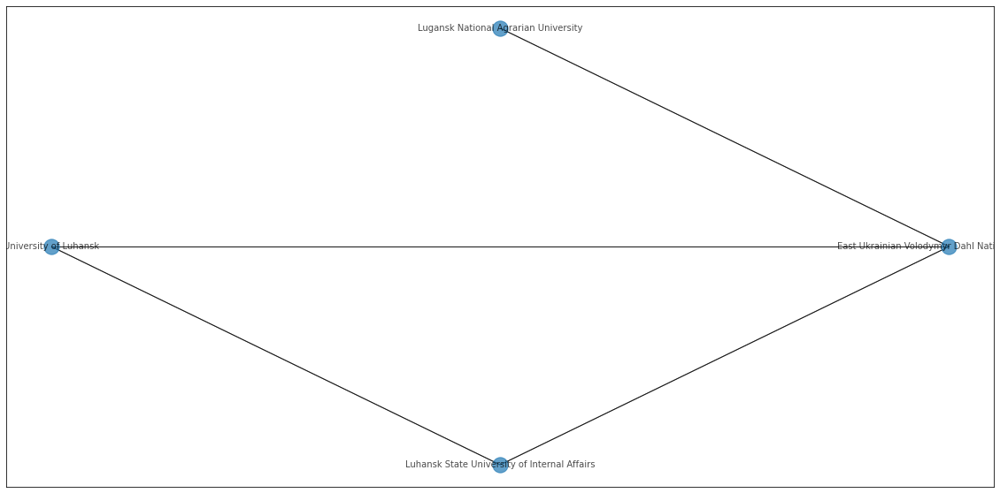

In [121]:

plt.figure(figsize=(20,10))
pos = nx.circular_layout(sub_g)
# el = nx.draw_networkx_edge_labels(sub_g, pos, edge_labels = edge_labels, font_size = 10, font_color = 'red')
# print(edge_labels)
nx.draw_networkx(sub_g,pos, font_size = 10, alpha=0.7, font_color = 'black')


In [122]:
### Choose components to 4070 nodes
l_4070 = [[s[0], s[1]] for s in S  if s[0] == 4070]
l_4070

[[4070, <networkx.classes.multigraph.MultiGraph at 0x7fdc637e6750>]]

In [123]:
g_4070 = l_4070[0][1]
print(nx.info(g_4070))

Name: 
Type: MultiGraph
Number of nodes: 4070
Number of edges: 59084
Average degree:  29.0339


In [124]:
ll = [{(l[0],l[1]):l[2]['person']} for l in list(g_4070.edges.data())]
print(len(ll))
ll[:3]

59084


[{('Howard University', 'Lincoln University'): 'A. A. Birch, Jr.'},
 {('Howard University', 'Lincoln University'): 'A. A. Birch, Jr.'},
 {('Howard University', 'University of California, Berkeley'): 'Ajit Singh'}]

In [125]:
ll = [{(u,v),data['person']} for u,v,data in list(g_4070.edges.data())]
print(len(ll))
ll[:3]

59084


[{('Howard University', 'Lincoln University'), 'A. A. Birch, Jr.'},
 {('Howard University', 'Lincoln University'), 'A. A. Birch, Jr.'},
 {('Howard University', 'University of California, Berkeley'), 'Ajit Singh'}]

In [126]:
links_list= [[e,datadict]for e, datadict in GU.edges.items()]
links_list[:3]

[[('Howard University', 'Lincoln University', 0),
  {'person': 'A. A. Birch, Jr.',
   'birth_year': 1932.0,
   'activity_period': ['1946-'],
   'long_1': -77.02,
   'lat_1': 38.921666666667,
   'long_2': -75.92777777777799,
   'lat_2': 39.808333333333}],
 [('Howard University', 'Lincoln University', 1),
  {'person': 'A. A. Birch, Jr.',
   'birth_year': 1932.0,
   'activity_period': ['1946-'],
   'long_1': -75.92777777777799,
   'lat_1': 39.808333333333,
   'long_2': -77.02,
   'lat_2': 38.921666666667}],
 [('Howard University', 'University of California, Berkeley', 0),
  {'person': 'Ajit Singh',
   'birth_year': 1940.0,
   'activity_period': ['1946-'],
   'long_1': -122.259,
   'lat_1': 37.87,
   'long_2': -77.02,
   'lat_2': 38.921666666667}]]

In [127]:
### Search the links with several activity periods
[n for n in links_list  if len(n[1]['activity_period']) > 2][:3]

[[('Yale Law School', 'University of Alabama', 0),
  {'person': 'Bibb Graves',
   'birth_year': 1873.0,
   'activity_period': ['-1900', '1901-1945', '1946-'],
   'long_1': -72.928147,
   'lat_1': 41.311581,
   'long_2': -87.54611111111099,
   'lat_2': 33.210833333333}],
 [('Yale Law School', 'University of Alabama', 1),
  {'person': 'Bibb Graves',
   'birth_year': 1873.0,
   'activity_period': ['-1900', '1901-1945', '1946-'],
   'long_1': -87.54611111111099,
   'lat_1': 33.210833333333,
   'long_2': -72.928147,
   'lat_2': 41.311581}],
 [('Yale Law School', 'University of Texas School of Law', 0),
  {'person': 'C. Pope Caldwell',
   'birth_year': 1875.0,
   'activity_period': ['-1900', '1901-1945', '1946-'],
   'long_1': -72.928147,
   'lat_1': 41.311581,
   'long_2': -97.730762,
   'lat_2': 30.288666}]]

### **Create three subgraphs per activity period**

In [128]:
[[u,v,data] for u,v, data in GU.edges.data() if '-1900' in data['activity_period']][:1]

[['Howard University',
  'Ohio Wesleyan University',
  {'person': 'George W. Atkinson',
   'birth_year': 1845.0,
   'activity_period': ['-1900', '1901-1945'],
   'long_1': -77.02,
   'lat_1': 38.921666666667,
   'long_2': -83.0667,
   'lat_2': 40.2967}]]

In [129]:
sub_graphs = []
for pa in ['-1900', '1901-1945', '1946-']:
    
    rpa = pa.replace('-', '_')
    g_pa = 'g_' + (rpa[1:] if rpa[0] == '_' else rpa) 

    G = nx.MultiGraph()
    edges_sub_graph = [[u,v,data] for u,v, data in GU.edges.data() if pa in data['activity_period']]
    print(g_pa + ':', '\nedges: ', len(edges_sub_graph))

    nodes_list = []
    xyz = [(nodes_list.append(e[0]),nodes_list.append(e[1])) for e in edges_sub_graph]
    nodes = list(set(nodes_list))
    print('nodes: ', len(nodes), '\n ---')
    
    G.add_nodes_from(nodes)
    

    G.add_edges_from(edges_sub_graph)
    
    sub_graphs.append([pa, G])



g_1900: 
edges:  6598
nodes:  736 
 ---
g_1901_1945: 
edges:  16460
nodes:  1601 
 ---
g_1946_: 
edges:  53487
nodes:  4094 
 ---


In [130]:
for g in sub_graphs:
    print(g, '\n')
    print(nx.info(g[1]))

['-1900', <networkx.classes.multigraph.MultiGraph object at 0x7fdc627ec950>] 

Name: 
Type: MultiGraph
Number of nodes: 736
Number of edges: 6598
Average degree:  17.9293
['1901-1945', <networkx.classes.multigraph.MultiGraph object at 0x7fdc5a5fa710>] 

Name: 
Type: MultiGraph
Number of nodes: 1601
Number of edges: 16460
Average degree:  20.5621
['1946-', <networkx.classes.multigraph.MultiGraph object at 0x7fdc9bef46d0>] 

Name: 
Type: MultiGraph
Number of nodes: 4094
Number of edges: 53487
Average degree:  26.1295


In [131]:
for g in sub_graphs:
    closeness_centrality = nx.closeness_centrality(g[1])
    nx.set_node_attributes(g[1], closeness_centrality, 'closeness')
    degree = dict([(d[0], {'degree': d[1]}) for d in nx.degree(g[1])])
    nx.set_node_attributes(g[1], degree)

In [132]:
sub_graphs[0][1].nodes.data()

NodeDataView({'City College': {'closeness': 0.16658108953106376, 'degree': 6}, 'Trinity College': {'closeness': 0.3267203177567323, 'degree': 157}, 'Brandon University': {'closeness': 0.2635582176631637, 'degree': 2}, 'Meiji University': {'closeness': 0.0027210884353741495, 'degree': 6}, 'Case Western Reserve University School of Law': {'closeness': 0.22483452151475283, 'degree': 2}, 'University of Missouri': {'closeness': 0.2883935112506541, 'degree': 30}, 'Princeton University': {'closeness': 0.35202963814633836, 'degree': 163}, 'Dunoon Grammar School': {'closeness': 0.24013550976835893, 'degree': 1}, 'University of Jena': {'closeness': 0.28402391259534115, 'degree': 88}, 'The Manchester Grammar School': {'closeness': 0.2639060727678665, 'degree': 16}, 'Windham High School': {'closeness': 0.2195675341879065, 'degree': 4}, 'University of London': {'closeness': 0.3071472111630111, 'degree': 54}, 'Ypsilanti High School': {'closeness': 0.2600166898142005, 'degree': 6}, 'University of Dub